## Imports

In [1]:
import numpy as np
import pandas as pd
import os
import random, re, math
import tensorflow as tf, tensorflow.keras.backend as K
from tensorflow.keras.layers import Dense
from tensorflow.keras.models import Model
from tensorflow.keras import optimizers
from kaggle_datasets import KaggleDatasets

In [2]:
!pip install efficientnet
import efficientnet.tfkeras as efn

You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.


## TPU Setup

In [3]:
AUTO = tf.data.experimental.AUTOTUNE
# Detect hardware, return appropriate distribution strategy
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection. No parameters necessary if TPU_NAME environment variable is set. On Kaggle this is always the case.
    print('Running on TPU ', tpu.master())
except ValueError:
    tpu = None

if tpu:
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
else:
    strategy = tf.distribute.get_strategy() # default distribution strategy in Tensorflow. Works on CPU and single GPU.

print("REPLICAS: ", strategy.num_replicas_in_sync)


# Data access
GCS_DS_PATH = KaggleDatasets().get_gcs_path()

Running on TPU  grpc://10.0.0.2:8470
REPLICAS:  8


## Get Data
Due to the overlap between the multiple diseases and the scab and rust categories we will try to compensate for the difficulty in differentiating between these categories by using a series of binary classifiers. Each classifier will be trained on a different subset of classifications from the original four. The important distinction between a one vs all approach is that we will have separate classifiers for rust, including multiple diseases, and rust only. We do the same for scab. Then we will use a final multiclass classifier that will the output of the first six as input and will attempt to classifiy the actual class.

In [4]:
CSV_PATH = "/kaggle/input/plant-pathology-2020-fgvc7/"
BATCH_SIZE = 8 * strategy.num_replicas_in_sync
IMG_SIZE = 800
EPOCHS = 30
VERBOSE = 0 # Something about commits not working
SHOW_GRAPHS = True

In [5]:
train_csv = pd.read_csv(CSV_PATH + 'train.csv')
test_csv = pd.read_csv(CSV_PATH + 'test.csv')
sub = pd.read_csv(CSV_PATH + 'sample_submission.csv')

# Note that we have to shuffle here and not anywhere else
train_csv = pd.read_csv(CSV_PATH + 'train.csv')
train_csv = train_csv.sample(frac=1).reset_index(drop=True)

test_csv = pd.read_csv(CSV_PATH + 'test.csv')

# Get full image paths
train_paths = train_csv.image_id.apply(lambda image: GCS_DS_PATH + '/images/' + image + '.jpg').values
test_paths = test_csv.image_id.apply(lambda image: GCS_DS_PATH + '/images/' + image + '.jpg').values

In [6]:
def decodeImage(filename, label=None, img_size=(IMG_SIZE, IMG_SIZE)):
    
    bits = tf.io.read_file(filename)
    image = tf.image.decode_jpeg(bits, channels = 3)
    image = (tf.cast(image, tf.float32) / 127.5) - 1
    
    # A few images are rotated
    if image.shape != [1365, 2048, 3]:
        image = tf.image.rot90(image)
    
    image = tf.image.resize(image, img_size)
    
    if label is None:
        return image
    else:
        return image, label
    
def dataAugment(image, label=None, seed=2020):
    
    image = tf.image.random_flip_left_right(image, seed=seed)
    image = tf.image.random_flip_up_down(image, seed=seed)
           
    if label is None:
        return image
    else:
        return image, label
    
def getClassifierData(paths, labels, batch_size=BATCH_SIZE):
    
    ds = (
        tf.data.Dataset
        .from_tensor_slices((train_paths, labels))
        .map(decodeImage, num_parallel_calls=AUTO)
        .map(dataAugment, num_parallel_calls=AUTO)
        #.repeat() # Using repeat leads to inconsistent results when predicting this set (counts are always off)
        .batch(BATCH_SIZE)
        .prefetch(AUTO)
    )
    
    return ds

def calcWeights(df, label):
    'Docs'
    counts = df[label].value_counts()
    
    return {0 : counts[1] / sum(counts),
            1 : counts[0] / sum(counts)}

In [7]:
# C1 is healthy vs not healthy
train_csv['C1_Label'] = train_csv.apply(lambda row: 0 if row['healthy'] == 1 else 1, axis=1)
# C2 is rust vs not rust
train_csv['C2_Label'] = train_csv.apply(lambda row: 0 if row['rust'] == 1 else 1, axis=1)
# C3 is scab vs not scab
train_csv['C3_Label'] = train_csv.apply(lambda row: 0 if row['scab'] == 1 else 1, axis=1)
# C4 is both diseases vs one or none
train_csv['C4_Label'] = train_csv.apply(lambda row: 0 if row['multiple_diseases'] == 1 else 1, axis=1)
# C5 rust or both vs scab or none
train_csv['C5_Label'] = train_csv.apply(lambda row: 0 if row['multiple_diseases'] == 1 or row['rust'] == 1 else 1, axis=1)
# C6 rust or both vs scab or none
train_csv['C6_Label'] = train_csv.apply(lambda row: 0 if row['multiple_diseases'] == 1 or row['scab'] == 1 else 1, axis=1)

if SHOW_GRAPHS:
    train_csv.head(10)

In [8]:
test_dataset = (
    tf.data.Dataset
    .from_tensor_slices(test_paths)
    .map(decodeImage, num_parallel_calls=AUTO)
    .batch(BATCH_SIZE)
)

In [9]:
# This one doesn't use validation data, we may want to try adding that in again later

training_dict = {'C1' : {'Train' : getClassifierData(train_paths, train_csv['C1_Label'].values.reshape(-1,1)),
                         #'Val' : getClassifierData(val_data, 'C1_Label', batch_size=BATCH_SIZE),
                         'Weights' : calcWeights(train_csv, 'C1_Label')},
                 
                 'C2' : {'Train' : getClassifierData(train_paths, train_csv['C2_Label'].values.reshape(-1,1)),
                         #'Val' : getClassifierData(val_data, 'C2_Label', batch_size=BATCH_SIZE),
                         'Weights' : calcWeights(train_csv, 'C2_Label')},
                 
                 'C3' : {'Train' : getClassifierData(train_paths, train_csv['C3_Label'].values.reshape(-1,1)),
                         #'Val' : getClassifierData(val_data, 'C3_Label', batch_size=BATCH_SIZE),
                         'Weights' : calcWeights(train_csv, 'C3_Label')},
                 
                 'C4' : {'Train' : getClassifierData(train_paths, train_csv['C4_Label'].values.reshape(-1,1)),
                         #'Val' : getClassifierData(val_data, 'C4_Label', batch_size=BATCH_SIZE),
                         'Weights' : calcWeights(train_csv, 'C4_Label')},
                 
                 'C5' : {'Train' : getClassifierData(train_paths, train_csv['C5_Label'].values.reshape(-1,1)),
                         #'Val' : getClassifierData(val_data, 'C5_Label', batch_size=BATCH_SIZE),
                         'Weights' : calcWeights(train_csv, 'C5_Label')},
                 
                 'C6' : {'Train' : getClassifierData(train_paths, train_csv['C6_Label'].values.reshape(-1,1)),
                         #'Val' : getClassifierData(val_data, 'C6_Label', batch_size=BATCH_SIZE),
                         'Weights' : calcWeights(train_csv, 'C6_Label')},
                 'Test' : test_dataset
                }

## Data Exploration

In [10]:
from random import seed
from random import randint
import cv2
from matplotlib import pyplot as plt
import seaborn as sns

In [11]:
seed(8)
IMG_PATH = CSV_PATH + 'images/'
STEPS = train_csv.shape[0] // BATCH_SIZE
SHOW_IMAGES = True
NUM_PER_COL = 2
NUM_PER_ROW = 5

In [12]:
def showImages(df, num_per_col, num_per_row):
    
    fig = plt.figure(figsize=(num_per_row*30, num_per_col*30))

    for i in range(0, num_per_col * num_per_row):
        
        plt.subplot(num_per_col, num_per_row, i+1)
        
        image_id = df.iloc[randint(0, len(df)-1)]['image_id']
        image = cv2.imread(IMG_PATH + image_id + '.jpg', cv2.IMREAD_UNCHANGED)
        image = cv2.resize(image, (int(IMG_SIZE / 2), int(IMG_SIZE / 2)))
        
        plt.imshow(image)
        plt.axis('off')
        
    plt.tight_layout()
    plt.show()

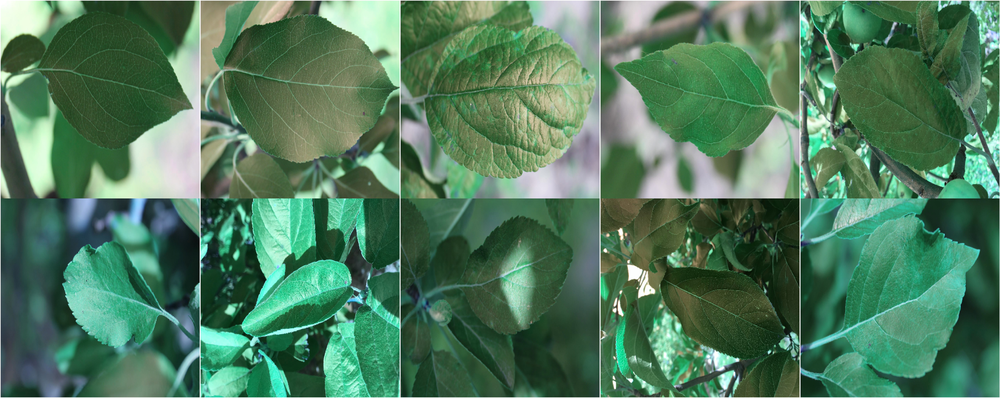

In [13]:
healthy_plants = train_csv[train_csv['healthy'] == 1]

if SHOW_IMAGES:
    showImages(healthy_plants, NUM_PER_COL, NUM_PER_ROW)

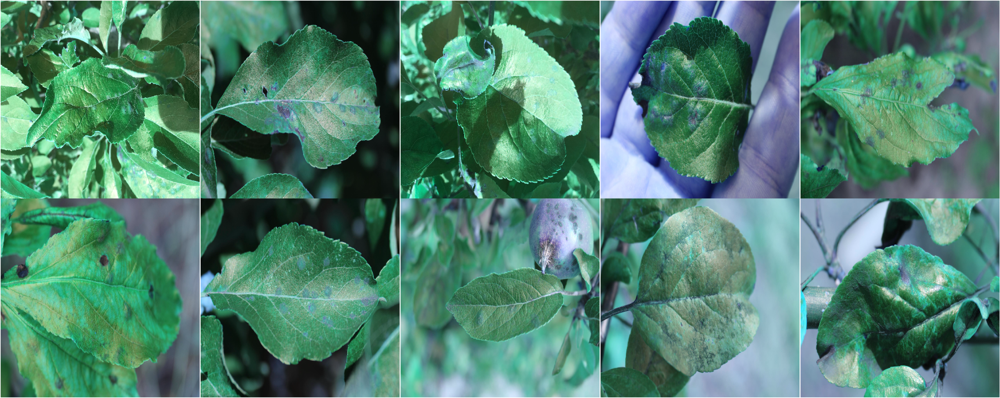

In [14]:
scab_plants = train_csv[train_csv['scab'] == 1]

if SHOW_IMAGES:
    showImages(scab_plants, NUM_PER_COL, NUM_PER_ROW)

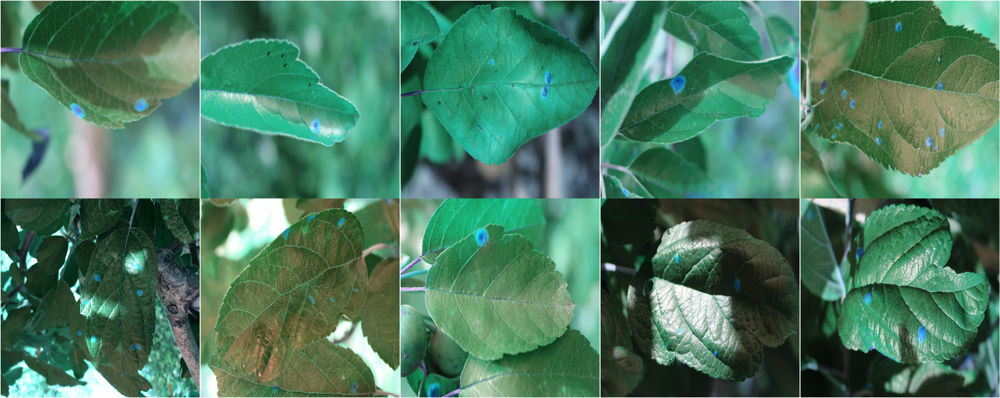

In [15]:
rust_plants = train_csv[train_csv['rust'] == 1]

if SHOW_IMAGES:
    showImages(rust_plants, NUM_PER_COL, NUM_PER_ROW)

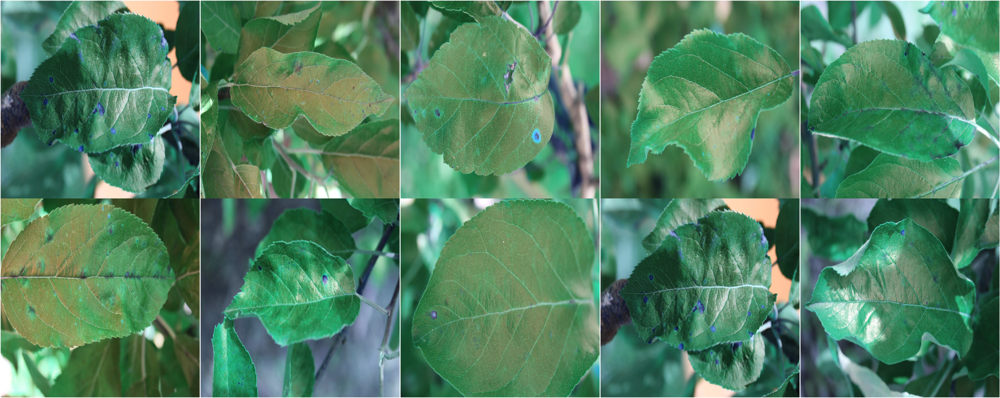

In [16]:
multiple_plants = train_csv[train_csv['multiple_diseases'] == 1]

if SHOW_IMAGES:
    showImages(multiple_plants, NUM_PER_COL, NUM_PER_ROW)

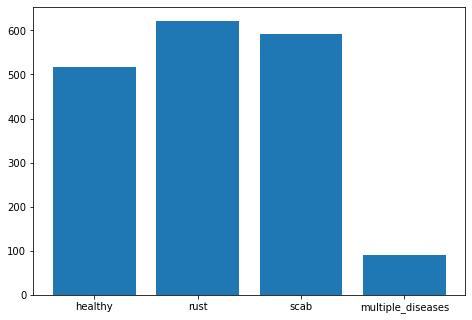

In [17]:
if SHOW_GRAPHS:
    fig = plt.figure()
    ax = fig.add_axes([0,0,1,1])
    labels = ['healthy', 'rust', 'scab', 'multiple_diseases']
    counts = [train_csv['healthy'].value_counts()[1], 
              train_csv['rust'].value_counts()[1],
              train_csv['scab'].value_counts()[1], 
              train_csv['multiple_diseases'].value_counts()[1]]
    ax.bar(labels, counts)
    plt.show()

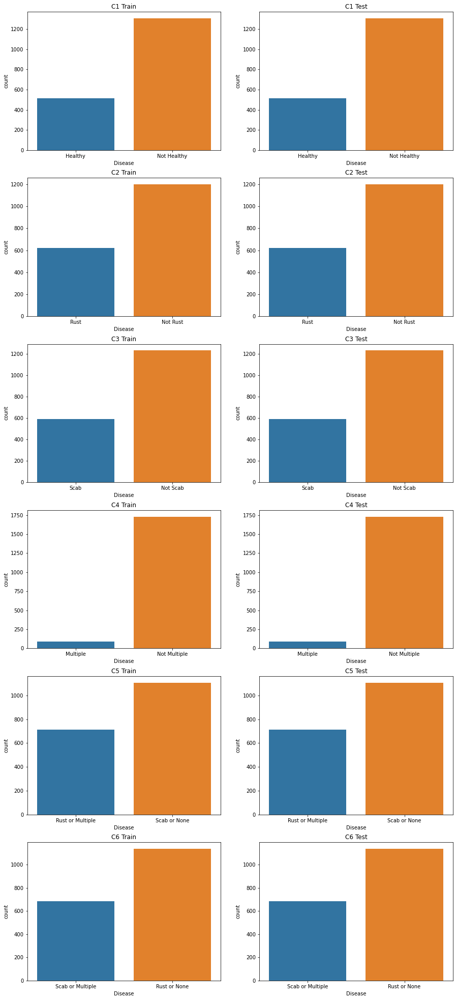

In [18]:
if SHOW_GRAPHS:
    fig = plt.figure(figsize=(15,35))

    plt.subplot(621)
    ax = sns.countplot(x='C1_Label', data=train_csv, order=[0, 1])
    ax.set_title('C1 Train')
    ax.set_xticklabels(['Healthy', 'Not Healthy'])
    ax.set(xlabel='Disease')

    plt.subplot(622)
    ax = sns.countplot(x='C1_Label', data=train_csv, order=[0, 1])
    ax.set_title('C1 Test')
    ax.set_xticklabels(['Healthy', 'Not Healthy'])
    ax.set(xlabel='Disease')

    plt.subplot(623)
    ax = sns.countplot(x='C2_Label', data=train_csv, order=[0, 1])
    ax.set_title('C2 Train')
    ax.set_xticklabels(['Rust', 'Not Rust'])
    ax.set(xlabel='Disease')

    plt.subplot(624)
    ax = sns.countplot(x='C2_Label', data=train_csv, order=[0, 1])
    ax.set_title('C2 Test')
    ax.set_xticklabels(['Rust', 'Not Rust'])
    ax.set(xlabel='Disease')

    plt.subplot(625)
    ax = sns.countplot(x='C3_Label', data=train_csv, order=[0, 1])
    ax.set_title('C3 Train')
    ax.set_xticklabels(['Scab', 'Not Scab'])
    ax.set(xlabel='Disease')

    plt.subplot(626)
    ax = sns.countplot(x='C3_Label', data=train_csv, order=[0, 1])
    ax.set_title('C3 Test')
    ax.set_xticklabels(['Scab', 'Not Scab'])
    ax.set(xlabel='Disease')

    plt.subplot(627)
    ax = sns.countplot(x='C4_Label', data=train_csv, order=[0, 1])
    ax.set_title('C4 Train')
    ax.set_xticklabels(['Multiple', 'Not Multiple'])
    ax.set(xlabel='Disease')

    plt.subplot(628)
    ax = sns.countplot(x='C4_Label', data=train_csv, order=[0, 1])
    ax.set_title('C4 Test')
    ax.set_xticklabels(['Multiple', 'Not Multiple'])
    ax.set(xlabel='Disease')

    plt.subplot(629)
    ax = sns.countplot(x='C5_Label', data=train_csv, order=[0, 1])
    ax.set_title('C5 Train')
    ax.set_xticklabels(['Rust or Multiple', 'Scab or None'])
    ax.set(xlabel='Disease')

    plt.subplot(6,2,10)
    ax = sns.countplot(x='C5_Label', data=train_csv, order=[0, 1])
    ax.set_title('C5 Test')
    ax.set_xticklabels(['Rust or Multiple', 'Scab or None'])
    ax.set(xlabel='Disease')

    plt.subplot(6,2,11)
    ax = sns.countplot(x='C6_Label', data=train_csv, order=[0, 1])
    ax.set_title('C6 Train')
    ax.set_xticklabels(['Scab or Multiple', 'Rust or None'])
    ax.set(xlabel='Disease')

    plt.subplot(6,2,12)
    ax = sns.countplot(x='C6_Label', data=train_csv, order=[0, 1])
    ax.set_title('C6 Test')
    ax.set_xticklabels(['Scab or Multiple', 'Rust or None'])
    ax.set(xlabel='Disease')

    plt.show()

## Model Stuff

Learning rate schedule: 1e-05 to 0.0008 to 7.79e-05


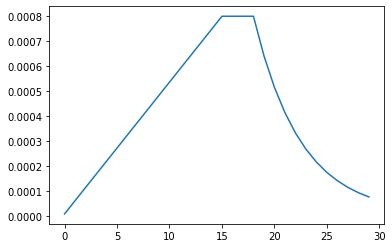

In [19]:
LR_START = 0.00001
LR_MAX = 0.0001 * strategy.num_replicas_in_sync
LR_MIN = 0.00001
LR_RAMPUP_EPOCHS = 15
LR_SUSTAIN_EPOCHS = 3
LR_EXP_DECAY = .8

def lrfn(epoch):
    if epoch < LR_RAMPUP_EPOCHS:
        lr = (LR_MAX - LR_START) / LR_RAMPUP_EPOCHS * epoch + LR_START
    elif epoch < LR_RAMPUP_EPOCHS + LR_SUSTAIN_EPOCHS:
        lr = LR_MAX
    else:
        lr = (LR_MAX - LR_MIN) * LR_EXP_DECAY**(epoch - LR_RAMPUP_EPOCHS - LR_SUSTAIN_EPOCHS) + LR_MIN
    return lr
    
lr_callback = tf.keras.callbacks.LearningRateScheduler(lrfn, verbose=True)

if SHOW_GRAPHS:
    rng = [i for i in range(EPOCHS)]
    y = [lrfn(x) for x in rng]
    plt.plot(rng, y)
    print("Learning rate schedule: {:.3g} to {:.3g} to {:.3g}".format(y[0], max(y), y[-1]))

In [20]:
def get_model():
    
    base_model =  efn.EfficientNetB7(weights='imagenet', include_top=False, 
                                     pooling='avg', input_shape=(IMG_SIZE, IMG_SIZE, 3))
    
    x = base_model.output
    output = Dense(1, activation="sigmoid")(x)
    
    return Model(inputs=base_model.input, outputs=output)

def fitModel(label, training_dict, lr_callback=lr_callback, epochs=EPOCHS, steps=STEPS, verbose=VERBOSE):
    
    with strategy.scope():
        model = get_model()

    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    
    model.fit(
        training_dict[label]['Train'],
        #steps_per_epoch = steps,
        callbacks = [lr_callback],
        #class_weight = training_dict[label]['Weights'] # Class weights still aren't working
        epochs = epochs,
        verbose = verbose
    )
    
    return model

def getPredictions(label, training_dict, steps=STEPS, verbose=VERBOSE):
    
    model = fitModel(label, training_dict)
    
    train_predictions = model.predict(training_dict[label]['Train'], #steps = steps,
                                use_multiprocessing = True, verbose = verbose)
    
    test_predictions = model.predict(training_dict['Test'], #steps = steps,
                                use_multiprocessing = True, verbose = verbose)
    
    # Releases tpu memory from model so other models can run
    tf.tpu.experimental.initialize_tpu_system(tpu)
    
    return train_predictions, test_predictions

In [21]:
predictions = [getPredictions('C1', training_dict),
               getPredictions('C2', training_dict),
               getPredictions('C3', training_dict),
               getPredictions('C4', training_dict),
               getPredictions('C5', training_dict),
               getPredictions('C6', training_dict)]

258441216/258434480 [==============================] - 8s 0us/step

Epoch 00001: LearningRateScheduler reducing learning rate to 1e-05.

Epoch 00002: LearningRateScheduler reducing learning rate to 6.266666666666667e-05.

Epoch 00003: LearningRateScheduler reducing learning rate to 0.00011533333333333334.

Epoch 00004: LearningRateScheduler reducing learning rate to 0.000168.

Epoch 00005: LearningRateScheduler reducing learning rate to 0.00022066666666666667.

Epoch 00006: LearningRateScheduler reducing learning rate to 0.0002733333333333334.

Epoch 00007: LearningRateScheduler reducing learning rate to 0.000326.

Epoch 00008: LearningRateScheduler reducing learning rate to 0.0003786666666666667.

Epoch 00009: LearningRateScheduler reducing learning rate to 0.0004313333333333334.

Epoch 00010: LearningRateScheduler reducing learning rate to 0.00048400000000000006.

Epoch 00011: LearningRateScheduler reducing learning rate to 0.0005366666666666667.

Epoch 00012: LearningRateScheduler r

In [22]:
train_predictions, test_predictions = zip(*predictions)
train_predictions = np.hstack(train_predictions)
test_predictions = np.hstack(test_predictions)

In [23]:
from keras import Sequential
from tensorflow.keras.layers import Dense, Dropout, Input

inputs = Input(shape=(train_predictions.shape[1],))
dense1 = Dense(200, activation='relu')(inputs)
dropout = Dropout(0.3)(dense1)
dense2 = Dense(50, activation='relu')(dropout)
outputs = Dense(4, activation='softmax')(dense2)
model_final = Model(inputs=inputs, outputs=outputs)

model_final.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

model_final.fit(
    train_predictions,
    train_csv[['healthy', 'multiple_diseases', 'rust', 'scab']].values,
    epochs = EPOCHS
)

Using TensorFlow backend.


Train on 1821 samples
Epoch 1/30
1821/1821 [==============================] - 1s 389us/sample - loss: 0.5563 - accuracy: 0.9121
Epoch 2/30
1821/1821 [==============================] - 0s 171us/sample - loss: 0.0310 - accuracy: 0.9995
Epoch 3/30
1821/1821 [==============================] - 0s 171us/sample - loss: 0.0086 - accuracy: 0.9995
Epoch 4/30
1821/1821 [==============================] - 0s 168us/sample - loss: 0.0059 - accuracy: 0.9989
Epoch 5/30
1821/1821 [==============================] - 0s 165us/sample - loss: 0.0049 - accuracy: 0.9989
Epoch 6/30
1821/1821 [==============================] - 0s 172us/sample - loss: 0.0039 - accuracy: 0.9989
Epoch 7/30
1821/1821 [==============================] - 0s 169us/sample - loss: 0.0025 - accuracy: 0.9995
Epoch 8/30
1821/1821 [==============================] - 0s 167us/sample - loss: 0.0047 - accuracy: 0.9989
Epoch 9/30
1821/1821 [==============================] - 0s 165us/sample - loss: 0.0037 - accuracy: 0.9995
Epoch 10/30
1821/1821 [=

## Predictions

In [24]:
sub_predictions = model_final.predict(test_predictions)

In [25]:
sub_predictions = pd.DataFrame(data=sub_predictions, columns=['healthy', 'multiple_diseases', 'rust', 'scab'])
sub_predictions = pd.concat([test_csv, sub_predictions], axis=1)
sub_predictions

,image_id,healthy,multiple_diseases,rust,scab
0,Test_0,0.000002,7.409464e-07,0.999996,0.000001
1,Test_1,0.000002,7.414313e-07,0.999996,0.000001
2,Test_2,0.000010,1.042465e-04,0.000006,0.999880
3,Test_3,0.999994,1.786278e-07,0.000002,0.000005
4,Test_4,0.000002,7.410927e-07,0.999996,0.000001
...,...,...,...,...,...
1816,Test_1816,0.000002,7.408898e-07,0.999996,0.000001
1817,Test_1817,0.000010,1.060654e-04,0.000006,0.999878
1818,Test_1818,0.000002,7.436421e-07,0.999996,0.000001
1819,Test_1819,0.999994,1.786070e-07,0.000002,0.000005


In [26]:
sub_predictions.to_csv('submission.csv', index=False)

## Resources
For this and for future reference
#### TPU Perfomance Optimizations
* https://www.kaggle.com/ateplyuk/fork-of-plant-2020-tpu-915e9c 
* https://www.kaggle.com/mgornergoogle/five-flowers-with-keras-and-xception-on-tpu 
* https://www.kaggle.com/docs/tpu
* https://codelabs.developers.google.com/codelabs/keras-flowers-data/#4
* https://www.tensorflow.org/guide/data_performance
* https://codelabs.developers.google.com/codelabs/keras-flowers-tpu/#3

#### Bayesian Optimization
* https://github.com/jeffheaton/t81_558_deep_learning/blob/master/t81_558_class_08_4_bayesian_hyperparameter_opt.ipynb
* https://github.com/fmfn/BayesianOptimization

#### NN Architecture
* https://towardsdatascience.com/guide-to-choosing-hyperparameters-for-your-neural-networks-38244e87dafe

#### Pretrained NNs
* https://github.com/jeffheaton/t81_558_deep_learning/blob/master/t81_558_class_09_1_keras_transfer.ipynb
* https://github.com/jeffheaton/t81_558_deep_learning/blob/master/t81_558_class_09_2_popular_transfer.ipynb
* https://github.com/jeffheaton/t81_558_deep_learning/blob/master/t81_558_class_09_3_transfer_cv.ipynb
* https://github.com/qubvel/efficientnet
* https://cs231n.github.io/transfer-learning/
* https://towardsdatascience.com/transfer-learning-from-pre-trained-models-f2393f124751

#### Data Augmentation
* https://www.pyimagesearch.com/2019/07/08/keras-imagedatagenerator-and-data-augmentation/

#### TF Dataset Resources
* https://www.tensorflow.org/tutorials/load_data/csv
* https://www.tensorflow.org/guide/data_performance